In [1]:
# !pip install "tensorflow>=2.0.0"
# !pip install --upgrade tensorflow-hub

In [2]:
import tensorflow as tf
import tensorflow_hub as hub
from PIL import Image
from PIL import ImageOps
import tempfile
from six.moves.urllib.request import urlopen
from six import BytesIO

In [3]:
# you can switch the commented lines here to pick the other model

# inception resnet version 2
module_handle = "https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1"

# You can choose ssd mobilenet version 2 instead and compare the results
#module_handle = "https://tfhub.dev/google/openimages_v4/ssd/mobilenet_v2/1"

In [4]:
# If this raises an error you need to delete the model folder from tmp (open $TMPDIR)
model = hub.load(module_handle)

INFO:tensorflow:Saver not created because there are no variables in the graph to restore


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


In [5]:
# take a look at the available signatures for this particular model
model.signatures.keys()

KeysView(_SignatureMap({'default': <ConcreteFunction pruned(images) at 0x7FDA4FFE5340>}))

In [6]:
detector = model.signatures['default']

In [7]:
def download_and_resize_image(url, new_width=256, new_height=256):
    '''
    Fetches an image online, resizes it and saves it locally.
    
    Args:
        url (string) -- link to the image
        new_width (int) -- size in pixels used for resizing the width of the image
        new_height (int) -- size in pixels used for resizing the length of the image
        
    Returns:
        (string) -- path to the saved image
    '''
    
    
    # create a temporary file ending with ".jpg"
    _, filename = tempfile.mkstemp(suffix=".jpg")
    
    # opens the given URL
    response = urlopen(url)
    
    # reads the image fetched from the URL
    image_data = response.read()
    
    # puts the image data in memory buffer
    image_data = BytesIO(image_data)
    
    # opens the image
    pil_image = Image.open(image_data)
    
    # resizes the image. will crop if aspect ratio is different.
    pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS)
    
    # converts to the RGB colorspace
    pil_image_rgb = pil_image.convert("RGB")
    
    # saves the image to the temporary file created earlier
    pil_image_rgb.save(filename, format="JPEG", quality=90)
    
    print("Image downloaded to %s." % filename)
    
    return filename

Image downloaded to /var/folders/fx/d_ymb6vs03lf3wnb0s0jmr0h0000gs/T/tmpn17agmwm.jpg.


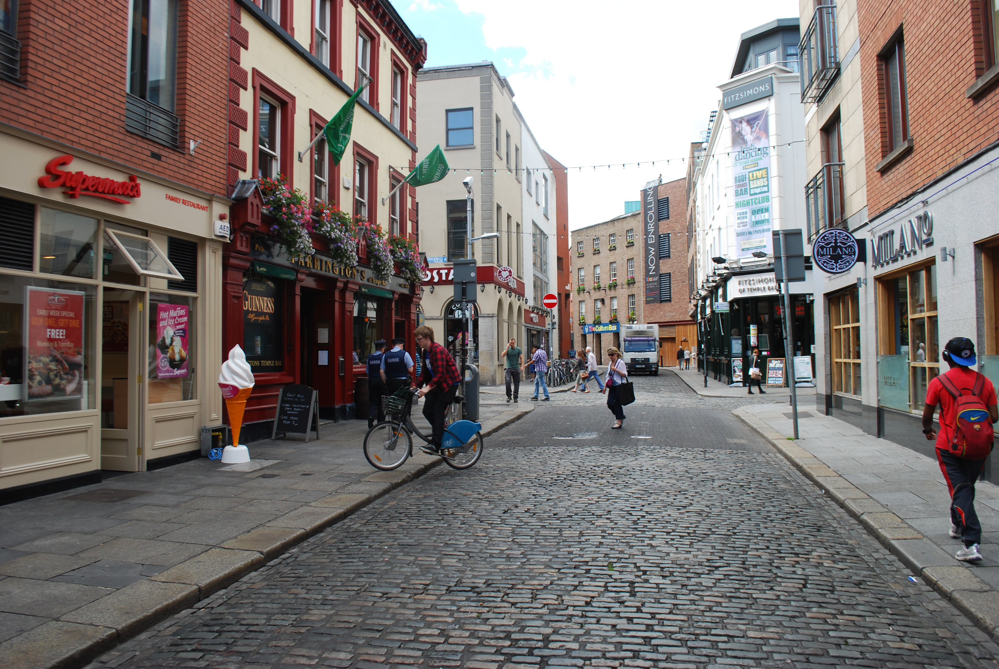

In [8]:
# You can choose a different URL that points to an image of your choice
image_url = "https://upload.wikimedia.org/wikipedia/commons/f/fb/20130807_dublin014.JPG"

# download the image and use the original height and width
downloaded_image_path = download_and_resize_image(image_url, 3872, 2592)

im = Image.open(downloaded_image_path)
display(im)
#im.show()

In [9]:
def load_img(path):
    '''
    Loads a JPEG image and converts it to a tensor.
    
    Args:
        path (string) -- path to a locally saved JPEG image
    
    Returns:
        (tensor) -- an image tensor
    '''
    
    # read the file
    img = tf.io.read_file(path)
    
    # convert to a tensor
    img = tf.image.decode_jpeg(img, channels=3)
    
    return img


def run_detector(detector, path):
    '''
    Runs inference on a local file using an object detection model.
    
    Args:
        detector (model) -- an object detection model loaded from TF Hub
        path (string) -- path to an image saved locally
    '''
    
    # load an image tensor from a local file path
    img = load_img(path)

    # add a batch dimension in front of the tensor
    converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
    
    # run inference using the model
    result = detector(converted_img)

    # save the results in a dictionary
    result_dic = {key:value.numpy() for key,value in result.items()}

    # print results
    print("Found %d objects." % len(result["detection_scores"]))

    print(result["detection_scores"])
    print(result["detection_class_entities"])
    print(result["detection_boxes"])
    
    im = Image.open(path)
    display(im)
    
    return result, result_dic


Found 100 objects.
tf.Tensor(
[0.6532177  0.6105045  0.6015258  0.59255654 0.5917771  0.58154935
 0.5505316  0.49575582 0.47424877 0.47322184 0.4406652  0.40511426
 0.39803794 0.3940657  0.37148535 0.36155936 0.36150715 0.34689158
 0.33362225 0.31252846 0.2887797  0.2575824  0.25748864 0.2519606
 0.24782133 0.2341237  0.20431976 0.20324676 0.1798825  0.17964773
 0.1737458  0.16431473 0.16031139 0.15895231 0.15620406 0.15468842
 0.1475448  0.13622677 0.12740059 0.12555613 0.1210271  0.11813048
 0.11387328 0.11229134 0.11129138 0.09718709 0.09137256 0.08976038
 0.08880259 0.08633587 0.08337479 0.08095182 0.07988789 0.07741442
 0.0773216  0.07631018 0.07507855 0.0738608  0.0723334  0.07204107
 0.07110198 0.06935614 0.06825598 0.06427873 0.06248545 0.06226398
 0.06211135 0.05940053 0.05798778 0.05784459 0.05725627 0.05346687
 0.05304344 0.05242875 0.04892622 0.04813047 0.04578416 0.04424165
 0.04337565 0.04277812 0.04262631 0.04163569 0.04081764 0.03975999
 0.03945963 0.03944279 0.0386399 

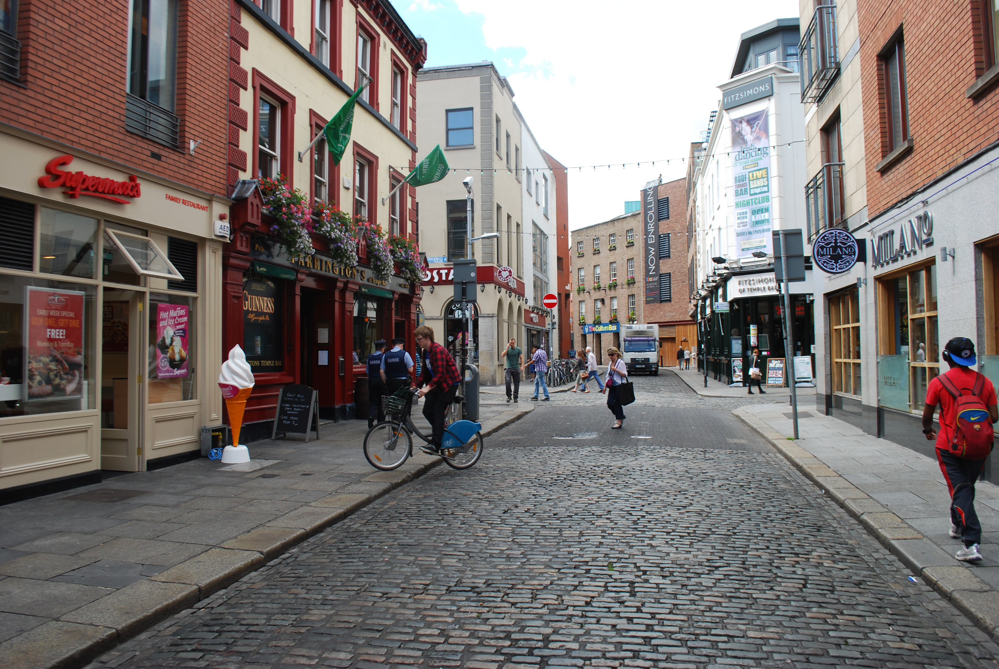

In [10]:
# runs the object detection model and prints information about the objects found
result, result_dic= run_detector(detector, downloaded_image_path)

Found 100 objects.
tf.Tensor(
[0.9757411  0.9679763  0.78843725 0.488623   0.3387601  0.33672833
 0.14108539 0.13713835 0.12863821 0.1246464  0.11016796 0.10702852
 0.10021178 0.08632463 0.0791848  0.06365074 0.05740279 0.05669459
 0.05525234 0.05286108 0.04860774 0.03570239 0.02965908 0.02481093
 0.02248874 0.01916293 0.0177912  0.0157517  0.0156332  0.01235311
 0.01195699 0.01119122 0.01070433 0.00965219 0.00751686 0.00733604
 0.00672655 0.00654676 0.00652457 0.00645799 0.00596664 0.00567398
 0.00533942 0.00466567 0.00454554 0.00433257 0.00418901 0.0040637
 0.00394457 0.00374592 0.00370757 0.00352975 0.00350735 0.00323777
 0.00315279 0.00314556 0.00313797 0.00304749 0.00301138 0.00275001
 0.00266737 0.00259438 0.00250031 0.00233988 0.00229413 0.00226798
 0.00213929 0.0020908  0.00207508 0.00206491 0.00202933 0.00199356
 0.0019745  0.00191475 0.00183767 0.00180142 0.00179856 0.00175423
 0.00172898 0.0017123  0.00170393 0.00165275 0.00156931 0.00156492
 0.00156449 0.00149832 0.00146823

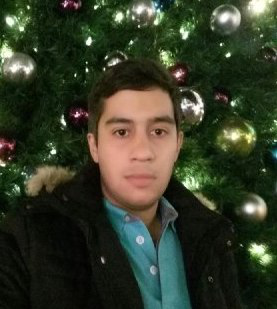

In [11]:
result, result_dic= run_detector(detector, 'Miralireza Nabavi.jpg')